# PTV Data Elementary Data Analysis - Anushka


## Loading data

In [15]:
import geopandas as gpd
import folium

gdf_bus = gpd.read_file("../data/landing/Order_G6Z8LX (1)/ll_gda94/esrishape/whole_of_dataset/victoria/PTV/PTV_METRO_BUS_STOP.shp")
gdf_train = gpd.read_file("../data/landing/Order_G6Z8LX (1)/ll_gda94/esrishape/whole_of_dataset/victoria/PTV/PTV_METRO_TRAIN_STATION.shp")
gdf_tram = gpd.read_file("../data/landing/Order_G6Z8LX (1)/ll_gda94/esrishape/whole_of_dataset/victoria/PTV/PTV_METRO_TRAM_STOP.shp")


## Shape Analysis

In [16]:
len(gdf_bus)

18559

In [17]:
gdf_bus = gdf_bus.dropna()
len(gdf_bus)

18428

In [18]:
len(gdf_tram)

1665

In [19]:
gdf_tram = gdf_tram.dropna()
len(gdf_tram)

1665

In [20]:
len(gdf_train)

220

In [21]:
gdf_train = gdf_train.dropna()
len(gdf_train)

220

In [22]:
import pandas as pd
import re

# Sample dataframe (assuming you've loaded it into a pandas DataFrame)
# Modify as necessary to work with your actual GeoDataFrame if it's in geopandas
# df = pd.DataFrame({'STOP_ID': ..., 'LATITUDE': ..., 'STOP_NAME': ...})

# Function to extract suburb from STOP_NAME
def extract_suburb(stop_name):
    # Use regex to find the text within parentheses (suburb name)
    match = re.search(r'\((.*?)\)', stop_name)
    if match:
        return match.group(1)  # Return the suburb inside parentheses
    else:
        return None  # Return None if no match is found

In [23]:
gdf_bus['SUBURB_NAME'] = gdf_bus['STOP_NAME'].apply(extract_suburb)
gdf_tram['SUBURB_NAME'] = gdf_tram['STOP_NAME'].apply(extract_suburb)
gdf_train['SUBURB_NAME'] = gdf_train['STOP_NAME'].apply(extract_suburb)


## Visualisations of densities of metro bus stops, tram stops & train stations 

In [24]:
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster

# Convert the GeoDataFrame to EPSG:4326 (WGS84) for folium compatibility
gdf = gdf_bus.to_crs(epsg=4283)

# Create a folium map centered on the mean latitude and longitude
mean_lat = gdf.geometry.y.mean()
mean_lon = gdf.geometry.x.mean()
m = folium.Map(location=[mean_lat, mean_lon], zoom_start=12, tiles='https://{s}.tile.openstreetmap.org/{z}/{x}/{y}.png', attr='OpenStreetMap')

# Use a MarkerCluster to group bus stop locations
marker_cluster = MarkerCluster().add_to(m)

# Add markers for each bus stop in the GeoDataFrame
for _, row in gdf.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup=f"Bus Stop: {row['STOP_NAME']} (Stop ID: {row['STOP_ID']})"
    ).add_to(marker_cluster)

# Save the map to an HTML file (optional)
m.save("../plots/metro_bus_stops_map.html")

# Display the map
m


In [25]:
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster

# Convert the GeoDataFrame to EPSG:4326 (WGS84) for folium compatibility
gdf = gdf_train.to_crs(epsg=4326)  # Ensure it's converted to EPSG:4326, not EPSG:4283 for folium

# Create a folium map centered on the mean latitude and longitude
mean_lat = gdf.geometry.y.mean()
mean_lon = gdf.geometry.x.mean()
m = folium.Map(location=[mean_lat, mean_lon], zoom_start=12, tiles='https://{s}.tile.openstreetmap.org/{z}/{x}/{y}.png', attr='OpenStreetMap')

# Use a MarkerCluster to group bus stop locations
marker_cluster = MarkerCluster().add_to(m)

# Add markers for each bus stop in the GeoDataFrame
for _, row in gdf.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup=f"Train Station: {row['STOP_NAME']} (Stop ID: {row['STOP_ID']})"
    ).add_to(marker_cluster)

# Save the map to an HTML file (optional)
m.save("../plots/metro_train_stations_map.html")

# Display the map
m


In [26]:
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster

# Convert the GeoDataFrame to EPSG:4326 (WGS84) for folium compatibility
gdf = gdf_tram.to_crs(epsg=4326)  # Ensure it's converted to EPSG:4326, not EPSG:4283 for folium

# Create a folium map centered on the mean latitude and longitude
mean_lat = gdf.geometry.y.mean()
mean_lon = gdf.geometry.x.mean()
m = folium.Map(location=[mean_lat, mean_lon], zoom_start=12, tiles='https://{s}.tile.openstreetmap.org/{z}/{x}/{y}.png', attr='OpenStreetMap')

# Use a MarkerCluster to group bus stop locations
marker_cluster = MarkerCluster().add_to(m)

# Add markers for each bus stop in the GeoDataFrame
for _, row in gdf.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup=f"Tram Stop: {row['STOP_NAME']} (Stop ID: {row['STOP_ID']})"
    ).add_to(marker_cluster)

# Save the map to an HTML file (optional)
m.save("../plots/tram_stops_map.html")

# Display the map
m


## Checking for Suburbs with Highest PTV Connectivity

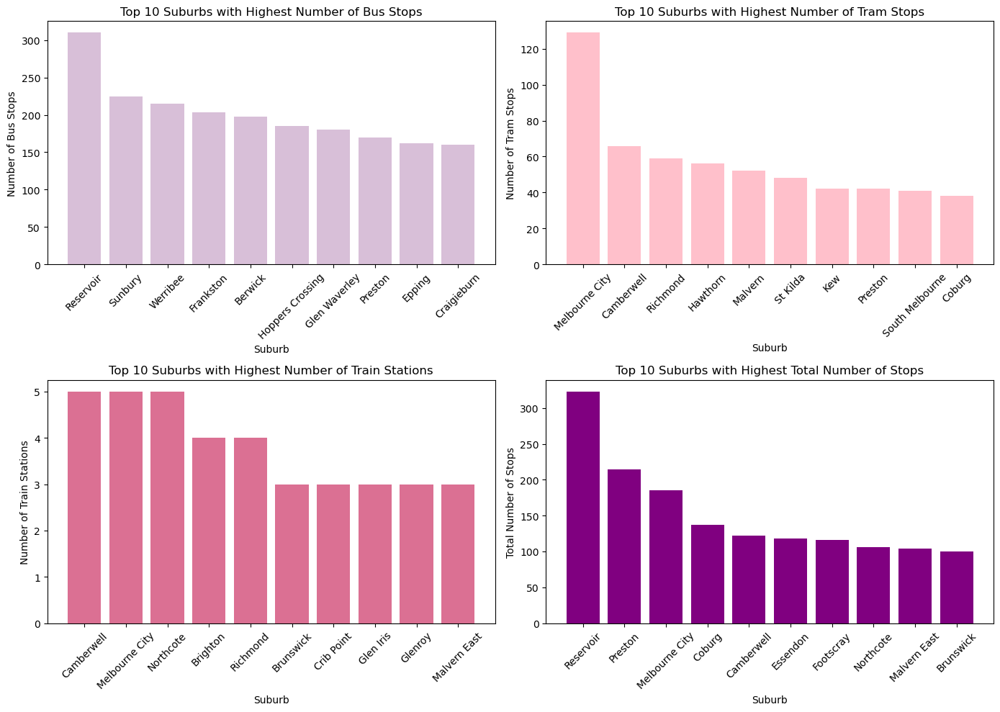

In [27]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming df_bus, df_tram, df_train are your respective DataFrames for buses, trams, and trains
# And 'SUBURB_NAME' has already been extracted from 'STOP_NAME'

# 1. Group by suburb and count stops for each transport mode
bus_stops_per_suburb = gdf_bus.groupby('SUBURB_NAME')['STOP_ID'].count().reset_index()
bus_stops_per_suburb.columns = ['SUBURB_NAME', 'bus_stop_count']

tram_stops_per_suburb = gdf_tram.groupby('SUBURB_NAME')['STOP_ID'].count().reset_index()
tram_stops_per_suburb.columns = ['SUBURB_NAME', 'tram_stop_count']

train_stations_per_suburb = gdf_train.groupby('SUBURB_NAME')['STOP_ID'].count().reset_index()
train_stations_per_suburb.columns = ['SUBURB_NAME', 'train_station_count']

# 2. Merge all the data to get total stops per suburb
connectivity_df = bus_stops_per_suburb.merge(tram_stops_per_suburb, on='SUBURB_NAME', how='outer')
connectivity_df = connectivity_df.merge(train_stations_per_suburb, on='SUBURB_NAME', how='outer')

# Add a column for the total number of stops (bus + tram + train)
connectivity_df['total_stop_count'] = (connectivity_df['bus_stop_count'] +
                                       connectivity_df['tram_stop_count'] +
                                       connectivity_df['train_station_count'])

# Sort by stop count for each mode to get the top 10 suburbs
top_10_bus_suburbs = connectivity_df.nlargest(10, 'bus_stop_count')
top_10_tram_suburbs = connectivity_df.nlargest(10, 'tram_stop_count')
top_10_train_suburbs = connectivity_df.nlargest(10, 'train_station_count')
top_10_total_suburbs = connectivity_df.nlargest(10, 'total_stop_count')

# 3. Create a 2x2 grid of plots
fig, axes = plt.subplots(2, 2, figsize=(14, 10))  # 2 rows, 2 columns

# Plot top 10 bus stops
axes[0, 0].bar(top_10_bus_suburbs['SUBURB_NAME'], top_10_bus_suburbs['bus_stop_count'], color='thistle')
axes[0, 0].set_title('Top 10 Suburbs with Highest Number of Bus Stops')
axes[0, 0].set_xlabel('Suburb')
axes[0, 0].set_ylabel('Number of Bus Stops')
axes[0, 0].tick_params(axis='x', rotation=45)

# Plot top 10 tram stops
axes[0, 1].bar(top_10_tram_suburbs['SUBURB_NAME'], top_10_tram_suburbs['tram_stop_count'], color='pink')
axes[0, 1].set_title('Top 10 Suburbs with Highest Number of Tram Stops')
axes[0, 1].set_xlabel('Suburb')
axes[0, 1].set_ylabel('Number of Tram Stops')
axes[0, 1].tick_params(axis='x', rotation=45)

# Plot top 10 train stations
axes[1, 0].bar(top_10_train_suburbs['SUBURB_NAME'], top_10_train_suburbs['train_station_count'], color='palevioletred')
axes[1, 0].set_title('Top 10 Suburbs with Highest Number of Train Stations')
axes[1, 0].set_xlabel('Suburb')
axes[1, 0].set_ylabel('Number of Train Stations')
axes[1, 0].tick_params(axis='x', rotation=45)

# Plot top 10 total stops (bus + tram + train)
axes[1, 1].bar(top_10_total_suburbs['SUBURB_NAME'], top_10_total_suburbs['total_stop_count'], color='purple')
axes[1, 1].set_title('Top 10 Suburbs with Highest Total Number of Stops')
axes[1, 1].set_xlabel('Suburb')
axes[1, 1].set_ylabel('Total Number of Stops')
axes[1, 1].tick_params(axis='x', rotation=45)

# Adjust layout for better spacing between plots
plt.tight_layout()

# Show the plot
plt.show()


In [28]:
import pandas as pd

# Load the Excel file
file_path = '../data/landing/hospital_mapping.xlsx'  # Replace with the correct file path
df = pd.read_excel(file_path, skiprows=3)

print(df.columns)

Index(['Code', 'Name', 'Type', 'Latitude', 'Longitude', 'Sector',
       'Open/Closed', 'State', 'Local Hospital Network (LHN)',
       'Primary Health Network area (PHN)'],
      dtype='object')


In [37]:
# Filter rows where the state is Victoria
victoria_hospitals = df[df['State'] == 'Victoria']
# Save the result to a new Excel or CSV file
victoria_hospitals.to_csv('../data/raw/vic_hospitals.csv', index=False)
# the dataset has instances of "closed" hospitals, which have null values for latitude and longitude 
victoria_hospitals = victoria_hospitals.dropna(subset=['Latitude', 'Longitude'])
print(victoria_hospitals)

        Code                                            Name  \
219    H0233      Western District Health Service [Hamilton]   
220    H0234     Western District Health Service [Penshurst]   
221    H0235                               Colac Area Health   
222    H0236         Hesse Rural Health Service [Winchelsea]   
223    H0237  Otway Health & Community Services [Apollo Bay]   
...      ...                                             ...   
1250  LHN291                                      NCN Health   
1251  LHN292                         Great Ocean Road Health   
1252  LHN293                  Central Highlands Rural Health   
1253  LHN294                                Grampians Health   
1254  LHN295                                 Dhelkaya Health   

                        Type   Latitude   Longitude  Sector Open/Closed  \
219                 Hospital -37.736495  142.030606  Public        Open   
220                 Hospital -37.877275  142.282487  Public        Open   
221   

In [32]:
victoria_hospitals.columns

Index(['Code', 'Name', 'Type', 'Latitude', 'Longitude', 'Sector',
       'Open/Closed', 'State', 'Local Hospital Network (LHN)',
       'Primary Health Network area (PHN)'],
      dtype='object')

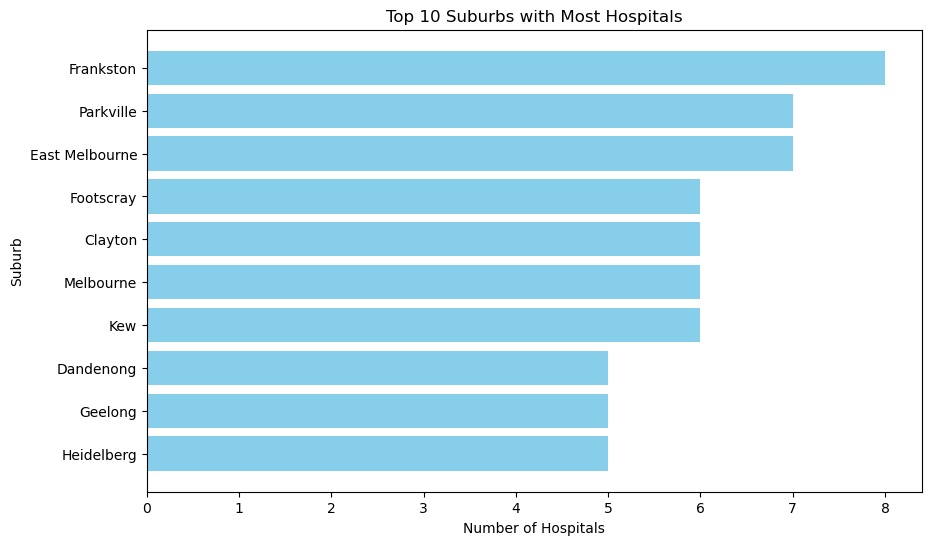

In [34]:
import matplotlib.pyplot as plt 
import pandas as pd

hospital_df = pd.read_csv("../data/landing/hospital.csv")
# Group by 'Suburb' and count the number of hospitals
suburb_counts = hospital_df.groupby('Suburb').size().reset_index(name='Hospital Count')

# Sort the data by hospital count and select the top 10 suburbs
top_10_suburbs = suburb_counts.sort_values(by='Hospital Count', ascending=False).head(10)

# Plot the results
plt.figure(figsize=(10, 6))
plt.barh(top_10_suburbs['Suburb'], top_10_suburbs['Hospital Count'], color='skyblue')
plt.xlabel('Number of Hospitals')
plt.ylabel('Suburb')
plt.title('Top 10 Suburbs with Most Hospitals')
plt.gca().invert_yaxis()  # Invert y-axis to have the highest count at the top
plt.show()


In [36]:
print(len(hospital_df))

270
